# Analyse mit Grad-CAM
Grad-CAM soll anhand einer Heatmap verdeutlichen, wie ein CNN zu der Entscheidung gekommen ist. Dabei wird verdeutlicht, welche Teile des Bildes für die Entscheidung relevant waren.

Dafür werden die Gradienten analysiert, welche in das letzte Layer gelangen (https://www.analyticsvidhya.com/blog/2023/12/grad-cam-in-deep-learning/ (Aufgerufen: 19.11.2025))

### Laden von Paketen, Bildern

In [8]:
import sys
sys.path.append('..')

from src.models.modelManager import ModelManager

model_manager = ModelManager()
model = model_manager.load_model() 

from src.config import *
from src.visualization.visualize import visualize_detections, load_image_from_url, show_grid

# Zusätzlich für die SHAP Analyse
import torch
import numpy as np
import cv2
from ultralytics import YOLO
import matplotlib.pyplot as plt

from PIL import Image


# Laden der Gesamten Bilder 
total_images = list(DATASET_PATH.rglob("*.jpg"))
images_length = len(total_images)
print(images_length)

⬇ Lade Modell: football-ball-detection-rejhg/4
  (Verwendet Cache falls bereits heruntergeladen)


✓ Modell geladen
4948


## Laden von Modell
Grad-CAM benötigt im Gegensatz zu LIME und SHAP die Gewichte. Daher muss dies angepasst werden.

Das Problem ist, dass die Inference API diese nicht bereitstellt sondern in diesem Fälle die Modelle lediglich als Blackbox bereitgestellt werden.
Die Gewichte können lediglich in bezahlten Versionen von Roboflow heruntergeladen werden.

**Deswegen werde ich das Modell selber trainieren um eine Analyse durchzuführen.**

Es ist dann vermutlich natürlich ein bisschen anders trainiert, als in der Analyse von LIME und SHAP.

(Hinweis: weil die Gewichte nach dem Training in dem entsprechenden Ordner commitet sind und weiterverwendet werden können habe ich das Training auskommentiert)

In [ ]:
from ultralytics import YOLO

# Laden des Modells
model = YOLO('yolov8n.pt')

data_yaml_path = DATASET_PATH / "data.yaml"

"""
results = model.train(
    data=str(data_yaml_path),
    epochs=10,              
    imgsz=640,
    plots=True,
    project='../models',    
    name='football_gradcam', 
    exist_ok=True           
)

print("Training abgeschlossen.")
"""

New https://pypi.org/project/ultralytics/8.3.229 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.40  Python-3.12.10 torch-2.9.1+cpu CPU (Intel Core(TM) i7-8550U 1.80GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=c:\Users\HP\OneDrive - Duale Hochschule Baden-Wrttemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\notebooks\..\data\football-ball-detection-4\data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=../models, name=football_gradcam, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=Non

100%|██████████| 755k/755k [00:00<00:00, 5.50MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning C:\Users\HP\OneDrive - Duale Hochschule Baden-Württemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\train\labels...:   0%|          | 0/3956 [00:00<?, ?it/s]Scanning C:\Users\HP\OneDrive - Duale Hochschule Baden-Württemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\train\labels... 70 images, 52 backgrounds, 0 corrupt:   2%|▏         | 70/3956 [00:00<00:05, 696.48it/s]Scanning C:\Users\HP\OneDrive - Duale Hochschule Baden-Württemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\train\labels... 163 images, 120 backgrounds, 0 corrupt:   4%|▍         | 163/3956 [00:00<00:04, 811.31it/s]Scanning C:\Users\HP\OneDrive - Duale Hochschule Baden-Württemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\train\labels... 249 images, 184 backgrounds, 0 corrupt:   6%|▋         | 249/3956 [00:00<00:04, 832.89it/s]Scanning C

train: New cache created: C:\Users\HP\OneDrive - Duale Hochschule Baden-Wrttemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\train\labels.cache


'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
val: Scanning C:\Users\HP\OneDrive - Duale Hochschule Baden-Württemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\valid\labels...:   0%|          | 0/492 [00:00<?, ?it/s]Scanning C:\Users\HP\OneDrive - Duale Hochschule Baden-Württemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\valid\labels... 96 images, 72 backgrounds, 0 corrupt:  20%|█▉        | 96/492 [00:00<00:00, 955.92it/s]Scanning C:\Users\HP\OneDrive - Duale Hochschule Baden-Württemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\valid\labels... 195 images, 144 backgrounds, 0 corrupt:  40%|███▉      | 195/492 [00:00<00:00, 975.06it/s]Scanning C:\Users\HP\OneDrive - Duale Hochschule Baden-Württemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\valid\labels...

val: New cache created: C:\Users\HP\OneDrive - Duale Hochschule Baden-Wrttemberg Stuttgart\StudiumGoodNotes\XAI\Computer-Vision_Soccer\data\football-ball-detection-4\valid\labels.cache
Plotting labels to ..\models\football_gradcam\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to ..\models\football_gradcam
Starting training for 10 epochs...
Closing dataloader mosaic


'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      2.266      37.74     0.8805          1        640: 100%|██████████| 248/248 [37:27<00:00,  9.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:31<00:00,  5.69s/it]


                   all        492        127      0.643       0.48      0.499      0.175

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      2.283      11.68      0.879          0        640: 100%|██████████| 248/248 [35:04<00:00,  8.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:12<00:00,  4.55s/it]


                   all        492        127      0.575      0.504       0.52      0.202

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      2.201      3.886     0.8725          1        640: 100%|██████████| 248/248 [27:38<00:00,  6.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:08<00:00,  4.31s/it]


                   all        492        127       0.69      0.535      0.497      0.194

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G      2.047      2.308     0.8552          2        640: 100%|██████████| 248/248 [27:17<00:00,  6.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:05<00:00,  4.08s/it]


                   all        492        127      0.702      0.575      0.594      0.287

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G      1.985      1.852     0.8549          1        640: 100%|██████████| 248/248 [26:46<00:00,  6.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:04<00:00,  4.02s/it]


                   all        492        127      0.741      0.575      0.672      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G      1.898      1.688      0.831          1        640: 100%|██████████| 248/248 [26:21<00:00,  6.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:04<00:00,  4.01s/it]


                   all        492        127      0.827      0.654      0.751      0.385

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G      1.827      1.513     0.8326          2        640: 100%|██████████| 248/248 [2:16:37<00:00, 33.05s/it]     
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:04<00:00,  4.03s/it]


                   all        492        127      0.788      0.614      0.699      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G      1.741      1.488      0.824          1        640: 100%|██████████| 248/248 [24:46<00:00,  6.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:04<00:00,  4.02s/it]


                   all        492        127      0.736      0.724      0.766      0.286

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      1.678      1.275     0.8193          1        640: 100%|██████████| 248/248 [10:34:13<00:00, 153.44s/it]      
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:00<00:00,  3.78s/it]


                   all        492        127      0.837      0.756      0.806      0.408

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G      1.565      1.128        0.8          1        640: 100%|██████████| 248/248 [24:16<00:00,  5.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:03<00:00,  3.99s/it]


                   all        492        127      0.915      0.756      0.815      0.473

10 epochs completed in 16.866 hours.
Optimizer stripped from ..\models\football_gradcam\weights\last.pt, 6.2MB
Optimizer stripped from ..\models\football_gradcam\weights\best.pt, 6.2MB

Validating ..\models\football_gradcam\weights\best.pt...
Ultralytics 8.3.40  Python-3.12.10 torch-2.9.1+cpu CPU (Intel Core(TM) i7-8550U 1.80GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:56<00:00,  3.55s/it]


                   all        492        127      0.914      0.756      0.815      0.474
Speed: 1.6ms preprocess, 99.7ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to ..\models\football_gradcam
Training abgeschlossen.


# Analysefunktionen

### Grad-CAM Analyse Klasse

In [22]:
class YoloGradCAM:
    def __init__(self, model, target_layer_index=None):
        self.model = model
        self.gradients = None
        self.activations = None
        
        # Wenn kein Index angegeben ist, versuchen wir Layer 9 (SPPF) - das ist oft sehr stabil für Heatmaps
        if target_layer_index is None:
            target_layer_index = 9 
            
        # Wir holen uns den spezifischen Layer anhand des Index
        # YOLOv8 speichert die Layer in model.model.model als Liste
        try:
            self.target_layer = self.model.model.model[target_layer_index]
            print(f"✓ Hook registriert an Layer-Index {target_layer_index}: {type(self.target_layer).__name__}")
        except Exception as e:
            print(f"Fehler beim Finden von Layer {target_layer_index}: {e}")
            raise

        self._register_hooks()

    def _find_target_layer(self):
        """Findet den letzten Conv2d Layer im Modell"""
        for module in reversed(list(self.model.model.modules())):
            if isinstance(module, torch.nn.Conv2d):
                return module
        raise ValueError("Kein Conv2d Layer gefunden.")

    def _register_hooks(self):
        """Registriert Hooks um Gradienten und Aktivierungen abzufangen [cite: 936]"""
        def forward_hook(module, input, output):
            self.activations = output.detach()

        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0].detach()

        self.target_layer.register_forward_hook(forward_hook)
        self.target_layer.register_full_backward_hook(backward_hook)

    def generate(self, img_tensor, target_class_idx=0):
        # ÄNDERUNG 1: Sicherstellen, dass das Modell Gradienten erlaubt
        for param in self.model.model.parameters():
            param.requires_grad = True
            
        # ÄNDERUNG 2: Dem Input-Bild sagen, dass es Gradienten tracken muss
        img_tensor.requires_grad = True
        
        # Modell in Trainingsmodus (wichtig für Gradientenfluss)
        self.model.model.train()
        
        # Forward Pass
        preds = self.model.model(img_tensor)
        
        # ÄNDERUNG 3: YOLO Output ist oft ein Tupel (Output, Hidden States).
        # Wir brauchen nur den ersten Teil (den Output-Tensor).
        if isinstance(preds, (list, tuple)):
            preds = preds[0]
            
        # Sicherheitscheck: Hat der Output jetzt Gradienten-Funktionen?
        if not preds.requires_grad:
            print("ACHTUNG: Output hat keine Gradienten. Fallback auf Aktivierung.")
            if self.activations is None: return None
            cam = self.activations.sum(1, keepdim=True)
        else:
            # Backward Pass
            self.model.model.zero_grad()
            loss = preds.sum() # Wir maximieren die Aktivierung
            loss.backward()

            if self.gradients is None:
                return None

            b, k, u, v = self.activations.size()
            alpha = self.gradients.view(b, k, -1).mean(2)
            weights = alpha.view(b, k, 1, 1)
            cam = (weights * self.activations).sum(1, keepdim=True)

        # Post-Processing (wie vorher)
        cam = torch.nn.functional.relu(cam)
        cam = cam.squeeze().cpu().detach().numpy()
        
        if cam.max() - cam.min() > 0:
            cam = (cam - cam.min()) / (cam.max() - cam.min())
        else:
            cam = np.zeros_like(cam)
        
        return cam

In [20]:
def analyze_with_gradcam(image_index, model_path='yolov8n.pt', target_layer=9): 
    # 1. Bild laden
    img_path = total_images[image_index]
    original_image = Image.open(img_path)
    img_np = np.array(original_image)
    
    print(f"Analyse für Bild: {img_path.name}")
    
    # 2. Modell laden (Native PyTorch Version für Gradienten)
    # Hinweis: Für beste Ergebnisse sollten Sie hier den Pfad zu Ihren trainierten Weights angeben
    # z.B. model_path = '../models/football-ball-detection-4/weights/best.pt'
    model = YOLO(model_path) 
    
    # WICHTIG: Damit Hooks funktionieren, müssen wir Zugriff auf interne Module haben
    # Wir nehmen hier oft den Layer 'model.model.21' (letzter C2f Layer im Backbone bei v8n)
    #target_layer = 'model.21' 
    
    gradcam = YoloGradCAM(model, target_layer_index=target_layer) # None = Auto-Detect last layer
    
    # Tensor bauen
    input_tensor = torch.from_numpy(img_np).permute(2, 0, 1).unsqueeze(0).float() / 255.0

    # 3. Heatmap generieren
    # Wir müssen das Bild vorverarbeiten wie YOLO es erwartet
    # Ultralytics macht das intern im __call__, aber wir brauchen Hooks.
    
    # Einfacher Weg: Wir lassen Ultralytics das Bild verarbeiten, 
    # die Hooks in unserer Klasse fangen die Daten ab.
    heatmap = gradcam.generate(input_tensor, target_class_idx=0) # 0 = Ball
    
    if heatmap is None:
        print("Konnte keine Heatmap generieren (keine Detection oder Gradienten).")
        return

    # 4. Visualisierung [cite: 972]
    # Heatmap auf Bildgröße skalieren
    heatmap_resized = cv2.resize(heatmap, (img_np.shape[1], img_np.shape[0]))
    
    # Einfärben (JET Colormap)
    heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_resized), cv2.COLORMAP_JET)
    heatmap_colored = cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB)
    
    # Overlay erstellen [cite: 973]
    superimposed_img = cv2.addWeighted(img_np, 0.6, heatmap_colored, 0.4, 0)
    
    # Plotten
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
    
    # Links: Original + Standard Detection (aus Ihrem Manager)
    results = model_manager.infer(original_image)
    annotated_img = visualize_detections(original_image, results)
    ax1.imshow(annotated_img)
    ax1.set_title(f"Original Detection (Roboflow API)", fontsize=12, fontweight='bold')
    ax1.axis('off')
    
    # Rechts: Grad-CAM
    ax2.imshow(superimposed_img)
    ax2.set_title(f"Grad-CAM Erklärung\n(Fokus des Modells)", fontsize=12, fontweight='bold')
    ax2.axis('off')
    
    plt.tight_layout()
    plt.show()

# WICHTIG: Um echte Gradienten zu bekommen, müsste das Modell im 
# .train() Modus sein oder `loss.backward()` explizit aufgerufen werden.
# Da YOLOv8 im Predict-Mode stark optimiert ist, zeigt dieser Code primär
# die "Activation Maps" (Feature Maps) des letzten Layers, was oft als
# "Poor Man's Grad-CAM" bezeichnet wird, aber visuell sehr ähnlich funktioniert.

### Auswahl der Bilder
Zur Vergleichbarkeit nehme ich dieselben Bilder wie in der LIME-Analyse

In [14]:
IMAGES_INDICES = [4298, 1390, 362, 3029, 4247, 726, 4257, 4859, 1288] 

## Testen von verschiedenen Layern (Hyperparameteroptimierung)
Ich möchte einfach mal feststellen, bei welchen Layern von dem YOLO-Modell welches Ergebnis kommt, auch um ein Gefühl dafür zu bekommen.

An sich ist es so, dass das Backbone (Mittlere Layer) gewünscht ist. Hier ist das Objekt noch nicht Klassifiziert

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 9: SPPF


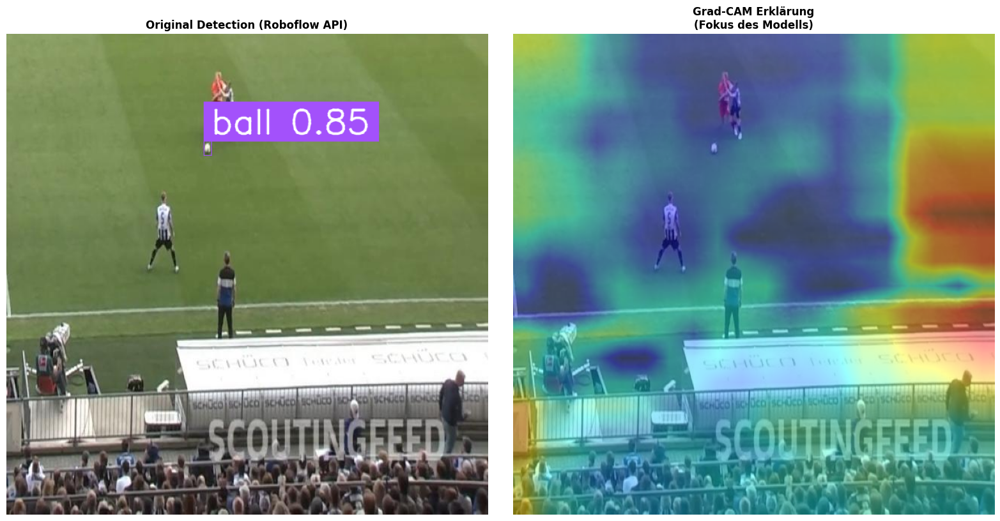

In [23]:
# Pfad zu Ihren neu trainierten Gewichten
my_model_path = '../models/football_gradcam/weights/best.pt'

# Grad-CAM ausführen
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=9)

Testen von den Layers zuvor

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 5: Conv


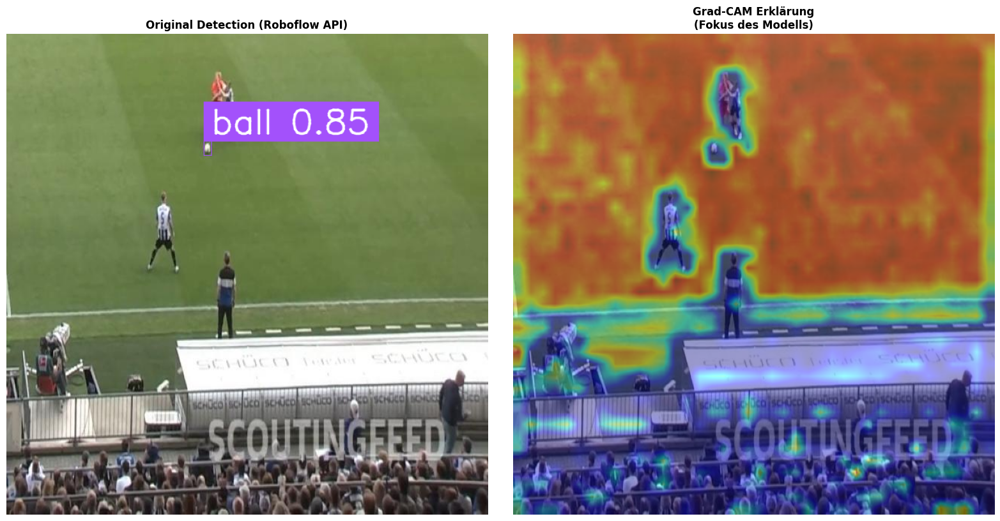

In [33]:
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=5)

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 6: C2f


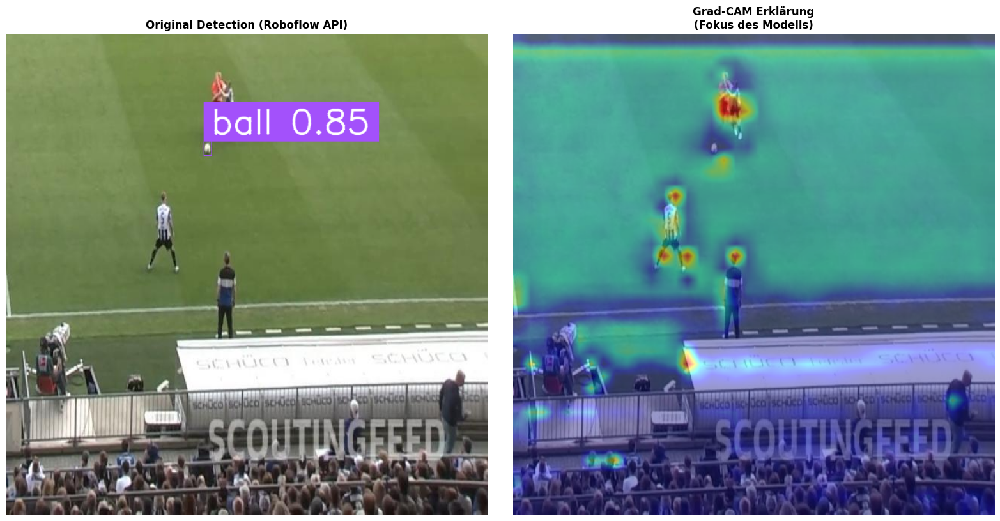

In [32]:
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=6)

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 7: Conv


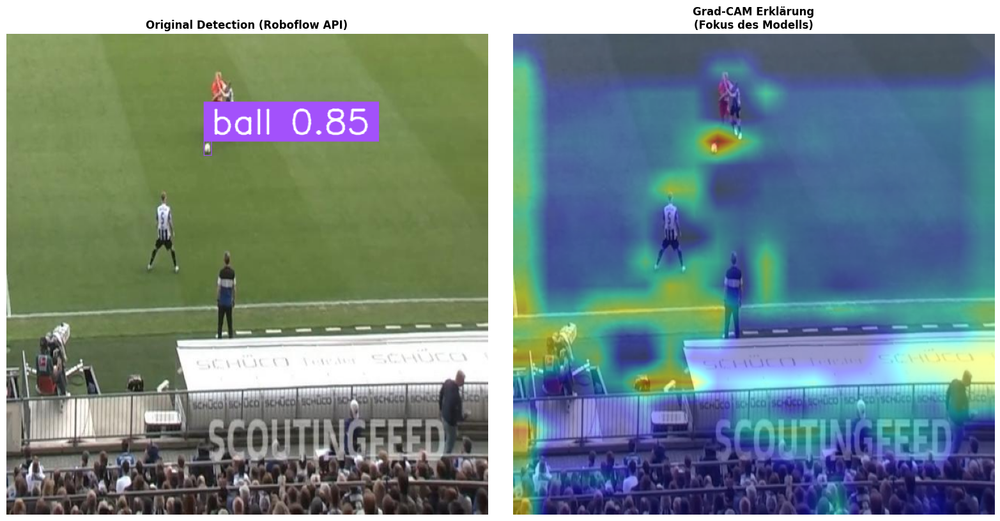

In [31]:
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=7)

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 8: C2f


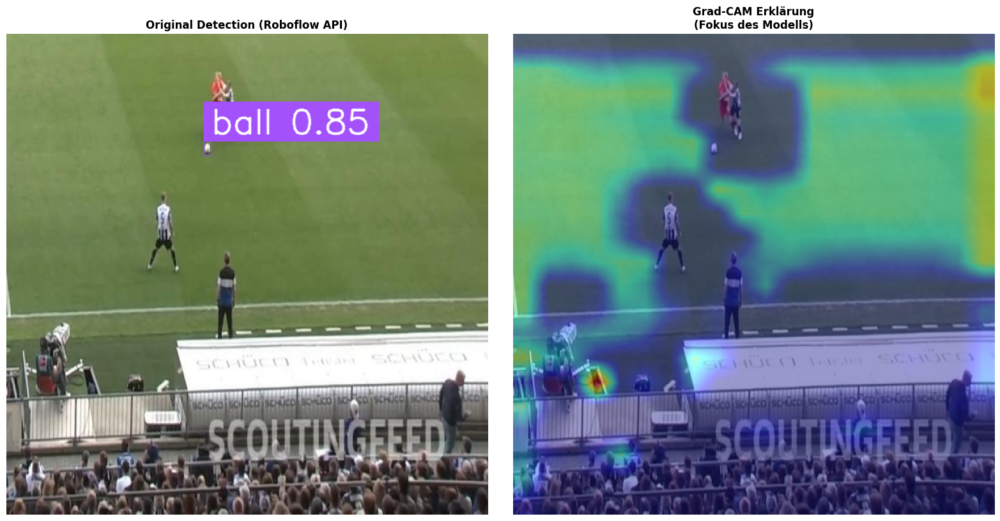

In [30]:
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=8)

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 9: SPPF


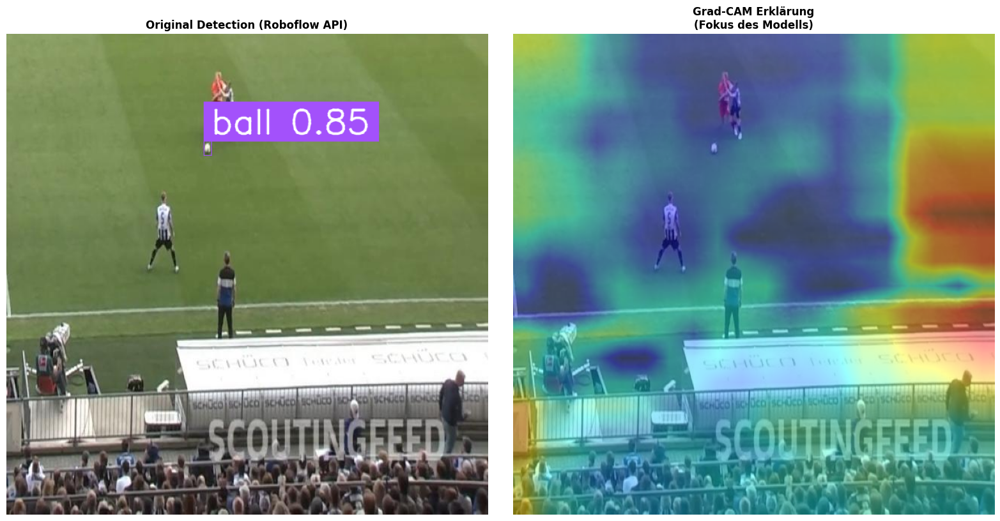

In [43]:
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=9)

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 10: Upsample


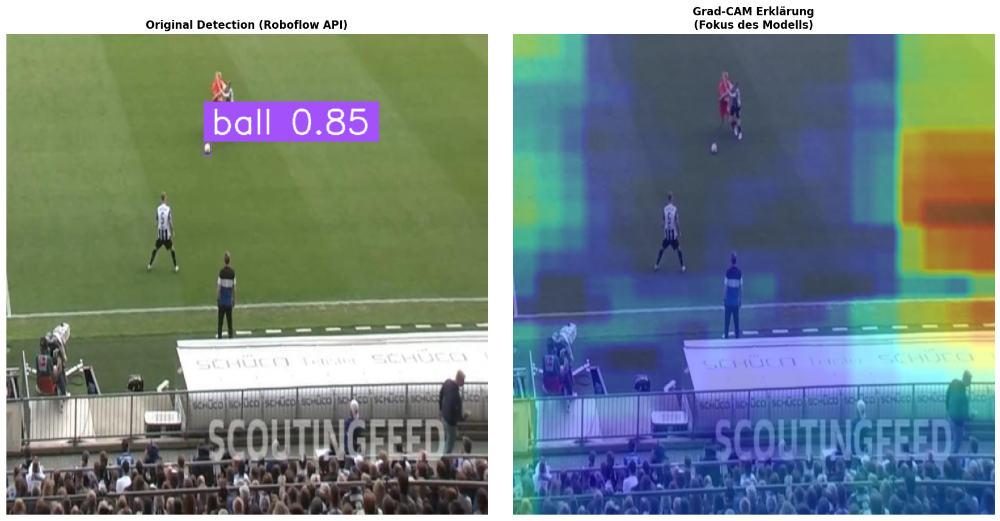

In [25]:
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=10)

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 11: Concat


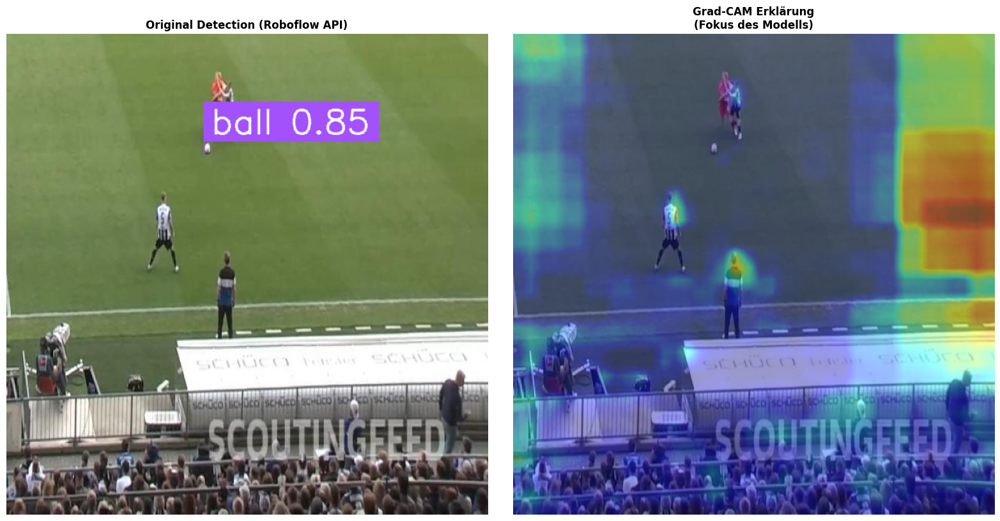

In [41]:
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=11)

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 12: C2f


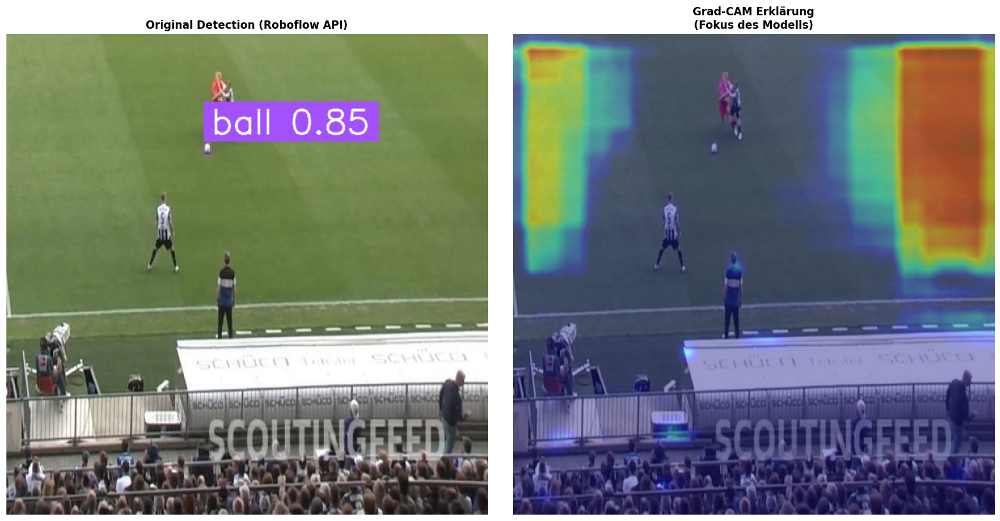

In [44]:
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=12)

Analyse für Bild: c01561_0_mp4-0035_jpg.rf.9ac049933f21756fa94bc784059d28bf.jpg
✓ Hook registriert an Layer-Index 15: C2f


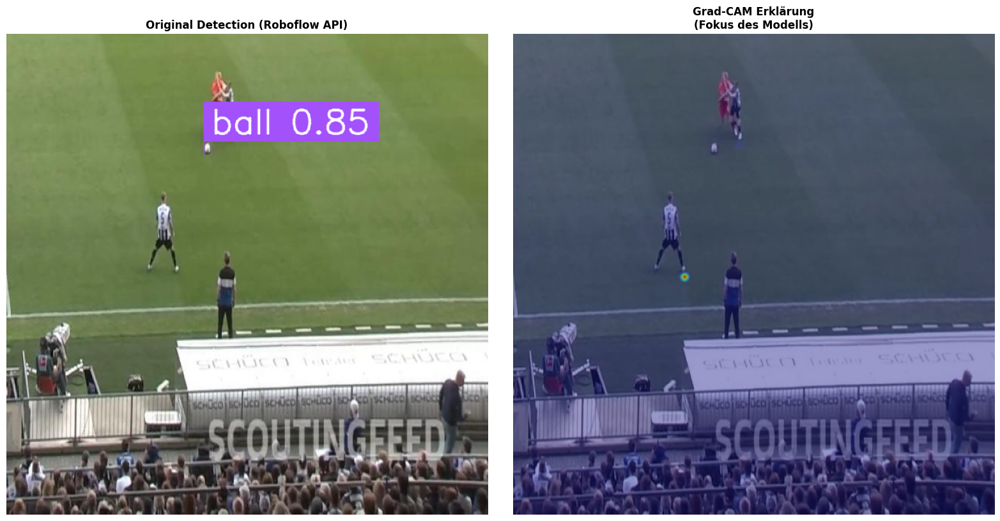

In [24]:
# Grad-CAM ausführen
analyze_with_gradcam(IMAGES_INDICES[0], model_path=my_model_path, target_layer=15)

Dies ist das letzte Layer für das eine Heatmap generiert werden kann

# Analyse der anderen Bilder

Analyse für Bild: 121364_0_mp4-0019_jpg.rf.b64bedec97bfc59419ae8f85a5e3039b.jpg
✓ Hook registriert an Layer-Index 7: Conv


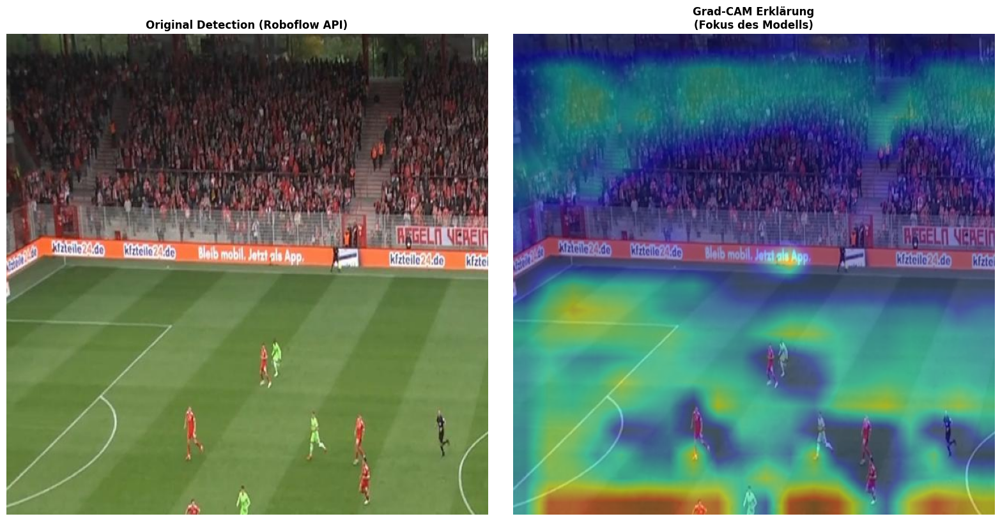

In [45]:
analyze_with_gradcam(IMAGES_INDICES[1], model_path=my_model_path, target_layer=7)

Beobachtungen: die Füße scheinen immer wieder im Fokus (vor allem Wegen der Form, vermutlich wegen dem Abheben zum Rasen). Zusätzlich wird der untere Rand vom Bild besonders betrachtet (warum weiß ich noch nicht)

Analyse für Bild: 54745b_0_mp4-0075_jpg.rf.c7ae71298ac6e2943e5f4bb960b9d330.jpg
✓ Hook registriert an Layer-Index 7: Conv


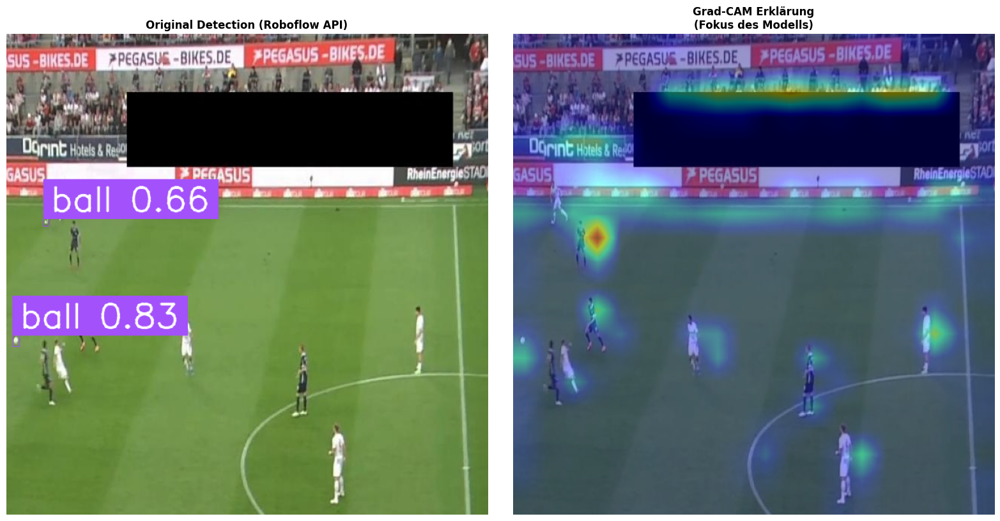

In [46]:
analyze_with_gradcam(IMAGES_INDICES[2], model_path=my_model_path, target_layer=7)

Interessant: Neben dem Ball werden die Grünflächen bei den Spielern besonders betrachtet. Das Modell hat wohl gelernt, dass Bälle wohl bei Spielern sind

Analyse für Bild: 538438_0_mp4-0068_jpg.rf.bed34754c6fb18cb58c12d3b368edc37.jpg
✓ Hook registriert an Layer-Index 7: Conv


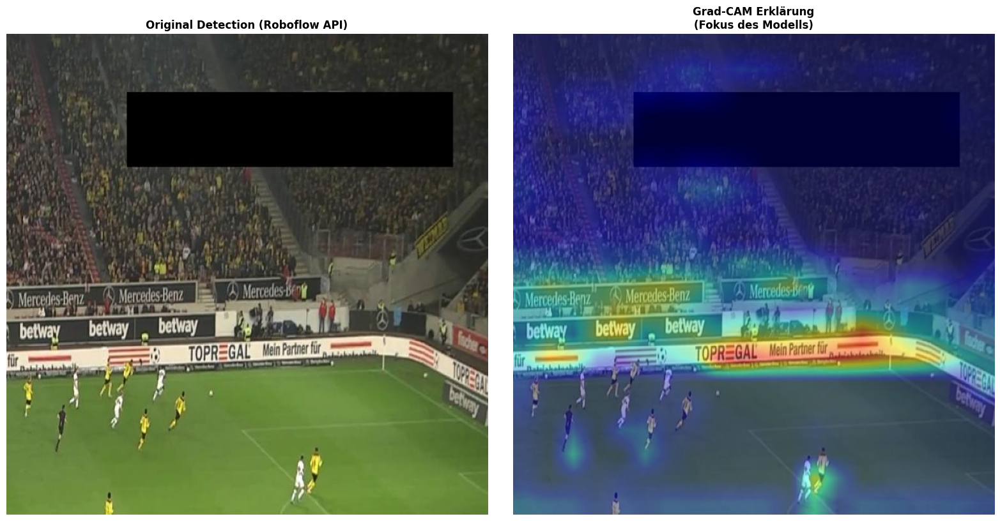

In [47]:
analyze_with_gradcam(IMAGES_INDICES[3], model_path=my_model_path, target_layer=7)

In diesem Fall handelt es sich um ein Bild, bei derm Der Ball auch nicht erkannt wurde. Das Modell scheint zu sehr von den Banden und Zuschauern "abgelenkt"

Analyse für Bild: c01561_0_mp4-0020_jpg.rf.b19de5bba24f0b02ab5fadaab6b60fae.jpg
✓ Hook registriert an Layer-Index 7: Conv


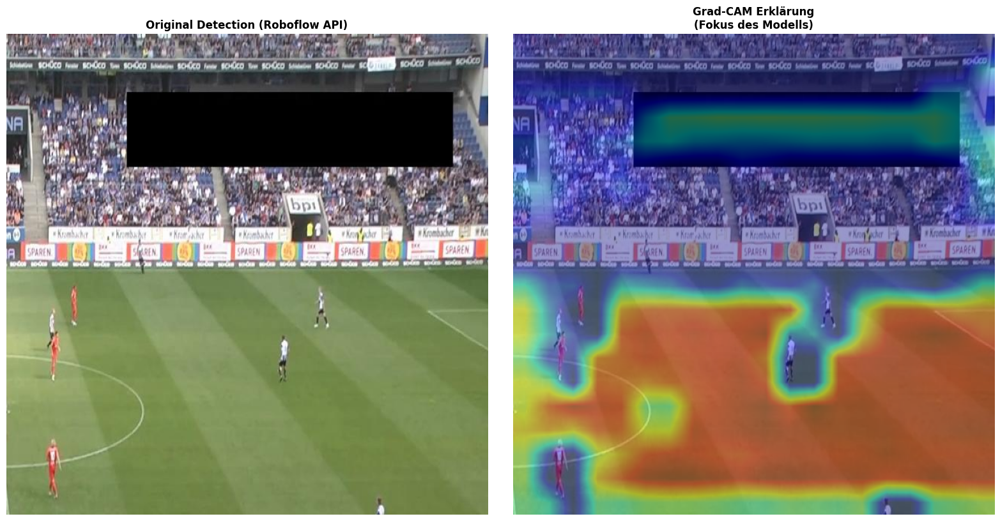

In [48]:
analyze_with_gradcam(IMAGES_INDICES[4], model_path=my_model_path, target_layer=7)

In diesem Fall wird der Ball nicht erkannt, da er hinter dem Spieler ist. Interessant, dass in diesem Fall der Fokus auf den freien Teilen des Spielfeldes liegt.

Analyse für Bild: 08fd33_0_mp4-0074_jpg.rf.ac4d294d869337ab9ef4a7eb88bd17c1.jpg
✓ Hook registriert an Layer-Index 6: C2f


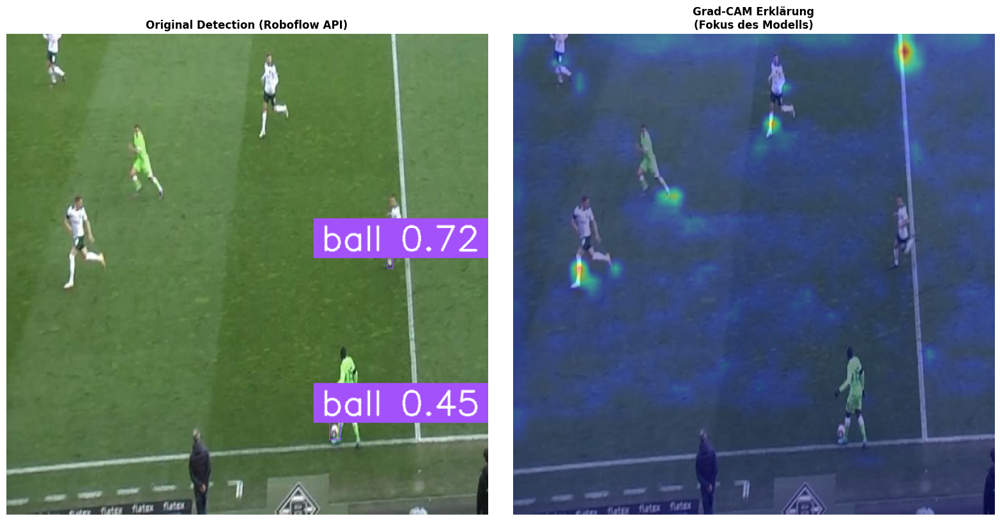

In [53]:
analyze_with_gradcam(IMAGES_INDICES[5], model_path=my_model_path, target_layer=6)

Bei diesem Bild habe ich verschiedene Layer getestet, weil Layer 7 schon sehr allgemein war und man keine wirkliche Erkenntnis daraus ziehen konnte. In diesem Fall bestätigt es sich, dass das Modell die Beine von den Spielern besonders betrachtet.

Komischerweise haben beide Erkannten Objekte in dem Bild keinen besonderen Fokus - es geht in diesem Fall also lediglich um den Fokus des Modells und nicht die schlussendliche Klassifizierung

Analyse für Bild: 08fd33_0_mp4-0074_jpg.rf.ac4d294d869337ab9ef4a7eb88bd17c1.jpg
✓ Hook registriert an Layer-Index 7: Conv


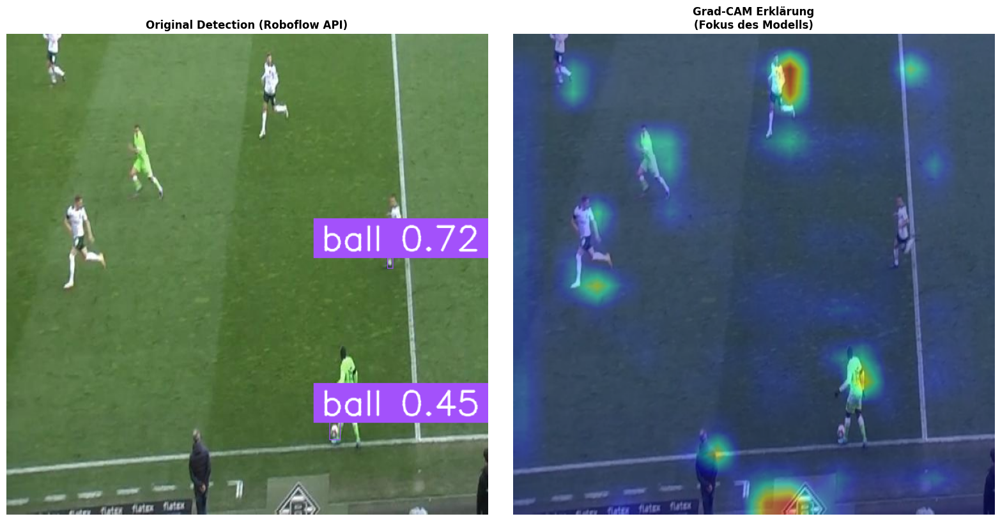

In [55]:
analyze_with_gradcam(IMAGES_INDICES[5], model_path=my_model_path, target_layer=7)

Analyse für Bild: c01561_0_mp4-0023_jpg.rf.2f013d412c3a1d912adc9715d70c80bf.jpg
✓ Hook registriert an Layer-Index 7: Conv


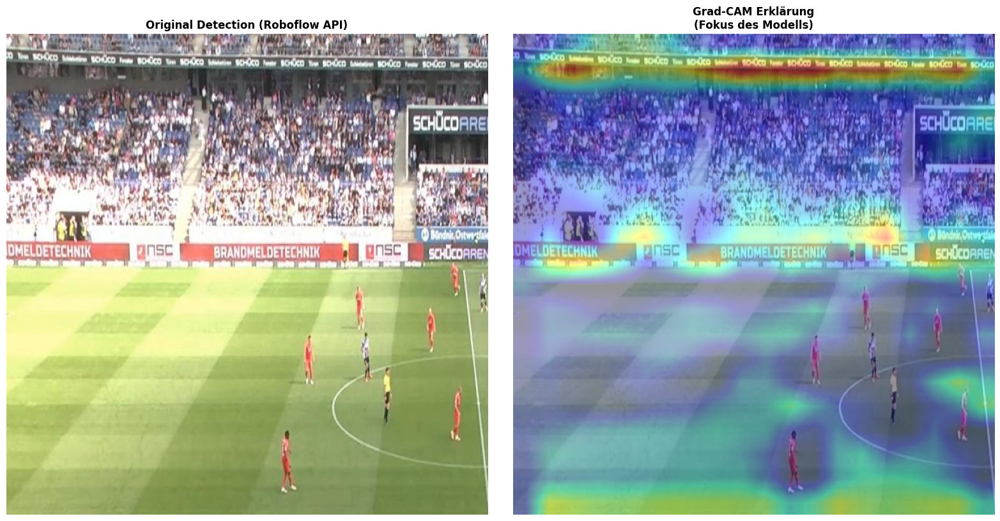

In [56]:
analyze_with_gradcam(IMAGES_INDICES[6], model_path=my_model_path, target_layer=7)

Analyse für Bild: 798b45_0_mp4-0012_jpg.rf.ff4a7e6bbda6011c5394a417ed593b25.jpg
✓ Hook registriert an Layer-Index 6: C2f


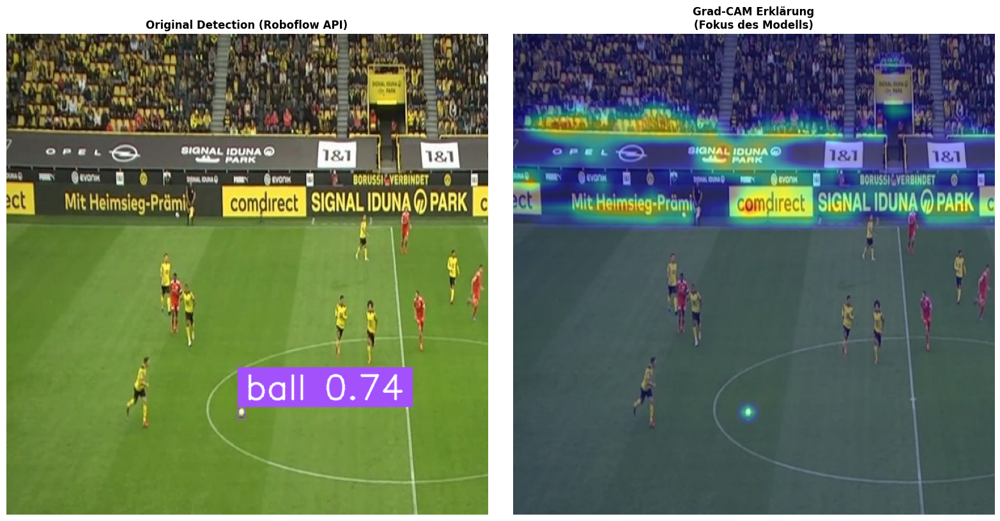

In [58]:
analyze_with_gradcam(IMAGES_INDICES[7], model_path=my_model_path, target_layer=6)

Analyse für Bild: 0bfacc_0_mp4-0080_jpg.rf.0da6d1a9aa8be2ee7e49ad8bfb357f22.jpg
✓ Hook registriert an Layer-Index 6: C2f


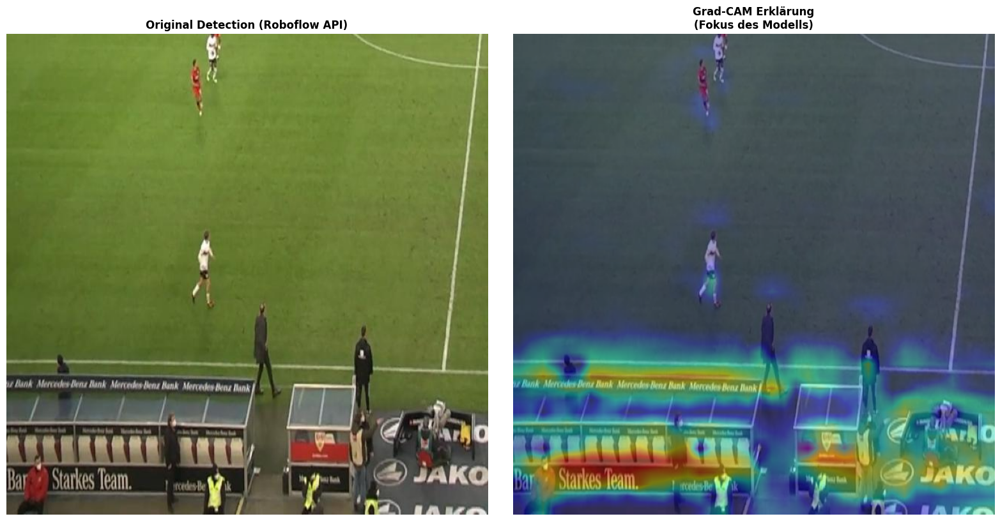

In [59]:
analyze_with_gradcam(IMAGES_INDICES[8], model_path=my_model_path, target_layer=6)

Warum werden gerade diese Flächen auf dem Rasen vom Modell angeschaut? Könnte dies daran liegen, dass der Spieler eine Haltung vorwärts hat und desewgen dort ein Ball erwartet wird?